## BERTTopic with subset

In [ ]:
1. Run the BERT model on the training data to label topic per each document.
2. For querying, 3 methods can be used. (TF-IDF, BERT, LSA), depends on goals. 

In [1]:
import pandas as pd
import torch
from transformers import BertTokenizer, BertModel
import re
# import bertopic
from bertopic import BERTopic
import spacy
import numpy as np
import matplotlib as plt
from bertopic.vectorizers import ClassTfidfTransformer
from bertopic.representation import KeyBERTInspired
from sklearn.datasets import fetch_20newsgroups
from collections import defaultdict
import numpy as np



In [109]:
df = pd.read_csv('data/kamers_text.csv')
#take 100000 random samples
df = df.sample(n=100000, random_state=1)
# df = pd.read_csv('data/kamers_onbewerkt.csv')

/var/folders/x6/923dwt55237392mlk00827nh0000gn/T/ipykernel_49887/2891986738.py:2: DtypeWarning:

Columns (3,4) have mixed types. Specify dtype option on import or set low_memory=False.



### pre-cleaning phase

In [110]:
#here better to add from API the column with the link to the original text
df.head()

,Unnamed: 0,index,id,text,date
130443,130443,31335,a1a32917-27cd-4333-ba03-b9d74b687615,\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n...,2012-10-30T00:00:00+01:00
234682,234682,35574,dffb17d3-8a52-47af-881a-25e0be7c3e72,\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n...,2016-10-03T00:00:00+02:00
117934,117934,18826,27c2c5ed-76cc-468e-959e-b46d8c9a5ef7,\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n...,2012-03-05T00:00:00+01:00
409120,409120,32346,51680de4-728f-43bc-8138-cf65a5e55112,\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n2\nNo.\t...,2021-05-07T00:00:00+02:00
202494,202494,3386,eb8ecfd9-6355-4926-adc1-72aab8e067ff,\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n...,2015-09-03T00:00:00+02:00


In [111]:
#delete on date column all after space
df['date'] = df['date'].str.split(' ').str[0]

In [112]:
#replace \n, \t, and \r with space in text column
df['text'] = df['text'].astype(str)
df.text = df.text.str.replace('\n', ' ')
df.text = df.text.str.replace('\t', ' ')
df.text = df.text.str.replace('\r', ' ')
#remove extra spaces with one space
df.text = df.text.str.replace(' +', ' ')
#remove numbers from text column
df.text = df.apply(lambda row: re.sub(r'\d+', '', row.text), 1)


In [113]:
df.head()

,Unnamed: 0,index,id,text,date
130443,130443,31335,a1a32917-27cd-4333-ba03-b9d74b687615,kst-- ISSN - ’s-Gravenhage Tweede Kamer de...,2012-10-30T00:00:00+01:00
234682,234682,35574,dffb17d3-8a52-47af-881a-25e0be7c3e72,Tweede Kamer der Staten-Generaal Vergaderjaa...,2016-10-03T00:00:00+02:00
117934,117934,18826,27c2c5ed-76cc-468e-959e-b46d8c9a5ef7,Bijeenkomst STIRR en Tweede Kamercommissie EL...,2012-03-05T00:00:00+01:00
409120,409120,32346,51680de4-728f-43bc-8138-cf65a5e55112,"No. 's-Gravenhage, Bij Kabinetsmissive van ...",2021-05-07T00:00:00+02:00
202494,202494,3386,eb8ecfd9-6355-4926-adc1-72aab8e067ff,Tweede Kamer der Staten-Generaal Vergaderjaa...,2015-09-03T00:00:00+02:00


In [114]:
#change the name of datum column to date
df.rename(columns={'date':'datum'}, inplace=True)
df['datum'] = pd.to_datetime(df['datum'], format='%Y-%m-%d', errors='coerce', utc=True)


In [115]:
df['day'] = df['datum'].dt.day
df['month'] = df['datum'].dt.month
df['year'] = df['datum'].dt.year
#make a timestamp column with datetime from day, month, year
df['timestep'] = pd.to_datetime(df[['day', 'month', 'year']])

<Axes: xlabel='year'>

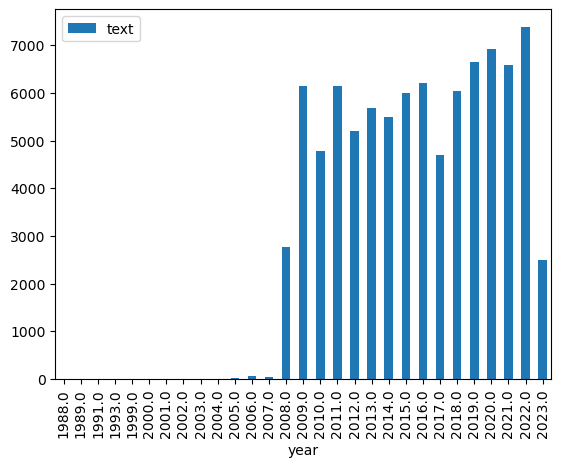

In [116]:
df.groupby('year').count()
#visualize the number of posts per year
df.groupby('year').count().plot(kind='bar', y='text')


#you can drop data before 2008 OR to run with the whole subset and compare results

In [118]:
column_format = df['timestep'].dtypes
print(column_format)

datetime64[ns]


In [12]:
df.head()

,Unnamed: 0,index,id,text,datum,day,month,year,timestep
130443,130443,31335,a1a32917-27cd-4333-ba03-b9d74b687615,kst-- ISSN - ’s-Gravenhage Tweede Kamer de...,2012-10-29 23:00:00+00:00,29.0,10.0,2012.0,2012-10-29
234682,234682,35574,dffb17d3-8a52-47af-881a-25e0be7c3e72,Tweede Kamer der Staten-Generaal Vergaderjaa...,2016-10-02 22:00:00+00:00,2.0,10.0,2016.0,2016-10-02
117934,117934,18826,27c2c5ed-76cc-468e-959e-b46d8c9a5ef7,Bijeenkomst STIRR en Tweede Kamercommissie EL...,2012-03-04 23:00:00+00:00,4.0,3.0,2012.0,2012-03-04
409120,409120,32346,51680de4-728f-43bc-8138-cf65a5e55112,"No. 's-Gravenhage, Bij Kabinetsmissive van ...",2021-05-06 22:00:00+00:00,6.0,5.0,2021.0,2021-05-06
202494,202494,3386,eb8ecfd9-6355-4926-adc1-72aab8e067ff,Tweede Kamer der Staten-Generaal Vergaderjaa...,2015-09-02 22:00:00+00:00,2.0,9.0,2015.0,2015-09-02


In [119]:
#check where the text is empty
df[df['text'] == 'nan']
#drop the rows where text is = 'nan'
df = df[df['text'] != 'nan']



In [14]:
#checking the data
df.iloc[107].text


' Tweede Kamer der Staten-Generaal  Vergaderjaar –   Mobiliteitsbeleid Nr.  VERSLAG VAN EEN ALGEMEEN OVERLEG Vastgesteld  maart  De vaste commissie voor Infrastructuur en Waterstaat heeft op  maart  overleg gevoerd met mevrouw Van Nieuwenhuizen-Wijbenga, Minister van Infrastructuur en Waterstaat, over: – de brief van de Minister van Infrastructuur en Waterstaat d.d.  november  inzake onderzoeken in het kader van vrachtwagenheffing (Kamerstuk  , nr. ); – de brief van de Minister van Infrastructuur en Waterstaat d.d.  november  inzake beleidskader vrachtwagenheffing (Kamerstuk  , nr. ); – de brief van de Minister van Infrastructuur en Waterstaat d.d.  januari  inzake voortgang vrachtwagenheffing (Kamerstuk  , nr. ); – de brief van de Minister van Infrastructuur en Waterstaat d.d.  februari  inzake beantwoording vragen commissie over voortgang vrachtwagenheffing (Kamerstuk  , nr. ) (Kamerstuk  , nr. ). Van dit overleg brengt de commissie bijgaand geredigeerd woordelijk verslag uit. De voo

In [120]:
#length of df
len(df)

87839

In [121]:
#check if there are any null values
df.isnull().sum()

Unnamed: 0    0
index         0
id            0
text          0
datum         0
day           0
month         0
year          0
timestep      0
dtype: int64

In [122]:
#drop rows where datum is NaN or null
df = df.dropna(subset=['datum'])
df = df.dropna(subset=['text'])
len(df)

df_sorted = df.sort_values('timestep')

In [123]:
len(df)

87839

In [124]:
#prepare lists to BERTopic
timestamps = df_sorted.datum.to_list()
doc_texts = df_sorted.text.to_list()

In [125]:
#method to exlude frequent words
ctfidf_model = ClassTfidfTransformer(reduce_frequent_words=True) #



In [126]:
topic_model = BERTopic(verbose=True, calculate_probabilities=True, language='multilingual', ctfidf_model=ctfidf_model) 
topics, probs = topic_model.fit_transform(doc_texts)

Batches:   0%|          | 0/2745 [00:00<?, ?it/s]

2023-06-20 21:40:25,171 - BERTopic - Transformed documents to Embeddings
2023-06-20 21:41:19,782 - BERTopic - Reduced dimensionality


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

2023-06-21 00:18:06,267 - BERTopic - Clustered reduced embeddings


In [127]:
topics_over_time = topic_model.topics_over_time(doc_texts, timestamps, datetime_format='mixed', nr_bins=36)


36it [37:42, 62.85s/it]


In [168]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,34398,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...
1,0,881,0_aanhangsel_ns_ingezonden_waterstaat,"[aanhangsel, ns, ingezonden, waterstaat, rijks...",[ Tweede Kamer der Staten-Generaal Vergaderja...
2,1,807,1_schoolboeken_schoolkosten_studenten_aanhangsel,"[schoolboeken, schoolkosten, studenten, aanhan...",[ Schriftelijke antwoorden op vragen gesteld t...
3,2,744,2_aanhangsel_dakloosheid_toelichten_ah,"[aanhangsel, dakloosheid, toelichten, ah, volk...",[ Tweede Kamer der Staten-Generaal Vergaderja...
4,3,703,3_castratie_ouderen_psychische_aandoeningen,"[castratie, ouderen, psychische, aandoeningen,...",[ www.trimbos.nl Trendrapportage G G Z Intern...
5,4,676,4_airport_lelystad_luchthaven_aviation,"[airport, lelystad, luchthaven, aviation, ufp,...",[ NLR - Nederlands Lucht- en Ruimtevaartcentru...
6,5,636,5_haren_sgbo_groet_verzonden,"[haren, sgbo, groet, verzonden, vriendelijke, ...",[ Ionderdeel Van: - BD DW]Z R ___________ Aan...
7,6,633,6_agendapunt_procedurevergadering_volgcommissi...,"[agendapunt, procedurevergadering, volgcommiss...","[ Den Haag, februari Voortouwcommissie: vast..."
8,7,583,7_xvi_igz_volksgezondheid_sport,"[xvi, igz, volksgezondheid, sport, welzijn, mz...",[ kst--XVI- ISSN - ’s-Gravenhage Tweede Kam...
9,8,563,8_iran_rif_inspreker_pakistan,"[iran, rif, inspreker, pakistan, redacted, lap...",[ SDG-rapportage EERSTE NEDERLANDSE SDG RAPPO...


In [413]:
topic_model.get_topic(5)

[('haren', 0.25581765870704043),
 ('sgbo', 0.2242292769425676),
 ('groet', 0.21786064155430504),
 ('verzonden', 0.19672758296190423),
 ('vriendelijke', 0.19564063030102788),
 ('limc', 0.17339445871097928),
 ('cc', 0.166052211692868),
 ('clas', 0.15687828077509058),
 ('kamerfractie', 0.15487268986224584),
 ('stationsweg', 0.1454613928537656)]

In [ ]:
#if it's needed - save ti csv 
csv.to_csv('data/topics.csv', index=False)

In [134]:
#to visualise the topics:
topic_model.visualize_topics_over_time(topics_over_time, topics=[54,]) 


In [135]:
topic_model.visualize_topics_over_time(topics_over_time, topics=[6,7,8,9,10]) #check 0,1,2

In [325]:
topic_model.visualize_topics_over_time(topics_over_time, topics=[54,78,160,107,5,8,599]) #check 0,1,2

In [581]:
topic_model.visualize_topics()

## TOPIC REDUCTION (for further tests)

In [102]:
from bertopic import BERTopic
topic_model_auto = BERTopic(nr_topics=13, verbose=True, calculate_probabilities=True, language='multilingual', ctfidf_model=ctfidf_model)
topics_auto, probs_auto = topic_model_auto.fit_transform(doc_texts)

Batches:   0%|          | 0/276 [00:00<?, ?it/s]

2023-06-11 17:08:49,038 - BERTopic - Transformed documents to Embeddings
2023-06-11 17:08:59,717 - BERTopic - Reduced dimensionality
2023-06-11 17:09:09,844 - BERTopic - Clustered reduced embeddings
2023-06-11 17:10:39,122 - BERTopic - Reduced number of topics from 154 to 13


In [201]:
doc_info = topic_model.get_document_info(doc_texts)
doc_info
# doc_info_fix

In [660]:
#make a plot of the number of topics over time
topic_model.visualize_topics_over_time(topics_over_time, topics=[0,1,2,3,4,5,6,7,8,9,10,11,12])



In [205]:
tfidf_matrix = vectorizer.fit_transform(doc_info['Document'])

In [659]:
topic_model.visualize_topics_over_time(topics_over_time, topics=[16,222,54, 704,432]) #check 0,1,2

In [215]:
#get first Document from top_topics
top_topics.iloc[8,0]



' Tweede Kamer der Staten-Generaal  Vergaderjaar –   Informatie- en communicatietechnologie (ICT) Nr.  LIJST VAN VRAGEN EN ANTWOORDEN Vastgesteld  december  De vaste commissie voor Binnenlandse Zaken heeft een aantal vragen voorgelegd aan de Minister voor Rechtsbescherming over de brief van  november  inzake de Kabinetsreactie op drietal onderzoeken naar algoritmen (Kamerstuk  , nr. ). De Minister heeft deze vragen beantwoord bij brief van  december . Vragen en antwoorden zijn hierna afgedrukt. De voorzitter van de commissie, Ziengs De adjunct-griffier van de commissie, Hendrickx kst-- ISSN  -  ’s-Gravenhage  Tweede Kamer, vergaderjaar –,  , nr.   Vraag  Wat is de definitie van algoritme? Antwoord op vraag  In het onderzoeksrapport van de Universiteit Utrecht over de juridische aspecten van algoritmen die besluiten nemen, beschrijven de auteurs algoritmen als volgt: «Een algoritme is in de kern een geschreven computerinstructie die met een bepaalde waarde of een reeks waarden als invoe

In [21]:
# Further reduce topics
reduced_topics = topic_model.reduce_topics(doc_texts, nr_topics=30)
print(reduced_topics)

2023-06-03 02:30:30,052 - BERTopic - Reduced number of topics from 106 to 40


BERTopic(calculate_probabilities=False, ctfidf_model=ClassTfidfTransformer(...), embedding_model=<bertopic.backend._sentencetransformers.SentenceTransformerBackend object at 0x7facc63f7ca0>, hdbscan_model=HDBSCAN(...), language=english, low_memory=False, min_topic_size=10, n_gram_range=(1, 1), nr_topics=40, representation_model=None, seed_topic_list=None, top_n_words=10, umap_model=UMAP(...), vectorizer_model=CountVectorizer(...), verbose=True)


In [44]:
data_topics = topic_model.get_document_info(doc_texts)
#show the Top_n_words for each topic
topic_model.get_topics()


{-1: [('beleid', 0.58294713),
  ('overheid', 0.5234779),
  ('ministerie', 0.5214907),
  ('toezicht', 0.5155191),
  ('als', 0.46537083),
  ('deel', 0.4578412),
  ('uitvoering', 0.45522523),
  ('the', 0.4520888),
  ('per', 0.4497364),
  ('informatie', 0.43363523)],
 0: [('volksgezondheid', 0.6604596),
  ('gezondheidszorg', 0.60350746),
  ('zorgverleners', 0.58987385),
  ('zorgaanbieders', 0.56397825),
  ('zorggebruikers', 0.5586883),
  ('zorg', 0.55857795),
  ('mantelzorgers', 0.55677056),
  ('gezondheid', 0.55370146),
  ('huisartsen', 0.54680103),
  ('medisch', 0.5329901)],
 1: [('staatssecretaris', 0.58133125),
  ('minister', 0.57415396),
  ('uitspraak', 0.5630365),
  ('voorzitter', 0.5568831),
  ('rechtsbijstand', 0.48806933),
  ('rechtspraak', 0.47811997),
  ('aanhangsel', 0.46021575),
  ('justitie', 0.45616013),
  ('vragen', 0.4540607),
  ('bericht', 0.4495052)],
 2: [('initiatiefnota', 0.4927346),
  ('initiatiefhouder', 0.49255693),
  ('voedselbanken', 0.49064377),
  ('warenautorit

In [295]:
doc_info = topic_model.get_document_info(doc_texts)
doc_info

,Document,Topic,Name,Representation,Representative_Docs,Top_n_words,Probability,Representative_document
0,Herziening Zorgstelsel Nr. BRIEF VAN DE MI...,-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.341318,False
1,Voorstel van wet van de leden Van Velzen en...,-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.096599,False
2,Toekomst AWBZ Nr. VERSLAG VAN EEN SCHRIFTE...,532,532_pgd_cak_zvw_gegevensoverdracht,"[pgd, cak, zvw, gegevensoverdracht, pgb, overh...",[ Toekomst AWBZ Nr. VERSLAG VAN EEN SCHRIFT...,pgd - cak - zvw - gegevensoverdracht - pgb - o...,0.438297,True
3,"- IF = - """" """" DCO Internationaal en Ruimteli...",-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.894242,False
4,Wijziging van de Wet rijonderricht motorrij...,-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.637622,False
...,...,...,...,...,...,...,...,...
87834,Bijlage Alle punten in deze bijlage zijn geca...,-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.063519,False
87835,Zee- en kustvisserij Nr. Brief van de mini...,70,70_glb_evf_fishing_visserij,"[glb, evf, fishing, visserij, fpas, visserijra...",[ kst--- ISSN - ’s-Gravenhage Tweede Kamer ...,glb - evf - fishing - visserij - fpas - visser...,0.002257,False
87836,Tweede Kamer der Staten-Generaal Vergaderjaa...,-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.609908,False
87837,Tweede Kamer der Staten-Generaal Vergaderjaa...,-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.253426,False


# Querying

## TFIDF - 1st method for querying


In [654]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Create the TF-IDF vectorizer
vectorizer = TfidfVectorizer()

# Fit the vectorizer on the documents
tfidf_matrix = vectorizer.fit_transform(doc_info['Document'])

def search_by_tfidf(input_text, top_k=20):
    # Transform the input text using the fitted vectorizer
    input_vector = vectorizer.transform([input_text])

    # Calculate the cosine similarity between the input vector and all document vectors
    similarities = (input_vector * tfidf_matrix.T).A.flatten()

    # Get indices of the top k most similar documents
    top_indices = similarities.argsort()[::-1][:top_k]

    # Retrieve the topics for the top indices
    top_topics = doc_info['Document'].iloc[top_indices]
    #show  two columns of df with top_indices
    top_topics = doc_info.iloc[top_indices, [0,1]]


    return top_topics


In [655]:
# Example usage: could be word of phrase
input_text = "fraude" #extremisme, fraudebestrijdingt, fraudebeleid, sociale zekerheid, kinderopvangtoeslag, toeslagenaffaire, handhaving, toeslagen
top_topics = search_by_tfidf(input_text)
print(top_topics)


                                                Document  Topic
75041    Stemming brief Instelling van een tijde- lij...    351
25797   Onderstaande lijst van vragen en antwoorden z...     -1
30096   Tweede Kamer der Staten-Generaal  Vergaderjaa...     -1
51377   > Retouradres Postbus   EE Den Haag De Nation...    710
75903   Tweede Kamer der Staten-Generaal  Vergaderjaa...    352
81367   , miljoen telefoontjes . bezwaren , miljoen m...     -1
70456   Schriftelijke verklaring van G.H. Blankestijn...    164
13239   Tweede Kamer der Staten-Generaal Postbus   EA...     -1
13308   ah-tk-- ISSN  -  ’s-Gravenhage  Tweede Kamer ...    210
73403   Den Haag,  april  Voortouwcommissie: vaste co...     -1
56637   Tweede Kamer der Staten-Generaal  Vergaderjaa...     -1
62298   Tweede Kamer der Staten-Generaal  Vergaderjaa...    194
28306   Den Haag,  september  Aan: alle leden Voortou...    269
28220   kst-- ISSN  -  ’s-Gravenhage  Tweede Kamer de...     -1
77815    Lijst  afgeronde toezeggingen n

In [597]:
#put a number of 
doc_info.iloc[73856].Document #54,67,160,5,8,107,699,78

' Tweede Kamer der Staten-Generaal Postbus   EA Den Haag T. - E. cie.fin@tweedekamer.nl Commissie Financiën Aan mevrouw Van Huffelen Plaats en datum: Den Haag,  mei  Betreft: Reactie m.b.t. toeslagenaffaire Ons kenmerk: Z/D Uw kenmerk: Uw brief van: In de procedurevergadering van de vaste commissie voor Financiën van  mei  is gesproken over een brief van mevrouw L. over de toeslagenaffaire. De commissie heeft besloten u te verzoeken om de behandeling over te nemen.. Bij deze breng ik u het verzoek van de commissie over. Hoogachtend, de griffier van de vaste commissie voor Financiën, A.H.M. Weeber '

In [606]:
topic_model.get_topic(25)

[('berck', 0.2458502515073836),
 ('hoogachtend', 0.21930949021377985),
 ('fin', 0.21822772808656635),
 ('financiën', 0.21391979342601322),
 ('breng', 0.2068949269518289),
 ('ea', 0.19599851176879654),
 ('cie', 0.1940097907628804),
 ('kenmerk', 0.19212164718842162),
 ('postbus', 0.1812992894303286),
 ('weeber', 0.177120808565482)]

In [648]:
topic_model.visualize_heatmap(topics=[16,24,124,55,260,19,222,432,102,128,298,678])  #54,78,160,5,8,107, 599,16,222,704,432,539,789,20,25

In [473]:
#show top 10 words for 54,78,160,107,5,8, 599 topics
topic_model.get_topic(16)




[('tsd', 0.19981017762281011),
 ('biza', 0.17977138612184723),
 ('ea', 0.16914557065405578),
 ('hoogachtend', 0.15571661025822753),
 ('ipcc', 0.15507702939113377),
 ('ads', 0.15289483118534453),
 ('postbus', 0.15230431057546656),
 ('efab', 0.13931018691234384),
 ('binnenlandse', 0.1383426460150121),
 ('kenmerk', 0.137132712623746)]

In [221]:
#get first Document from top_topics
top_topics.iloc[9,0]

' E-mailprocedure Z Van: Rajkowski, Q.M. (Queeny-Aimée) Verzonden: vrijdag  september  : Aan: Boeve, L. Onderwerp: CD Inzet algortimes en data-ethiek bij de rijksoverheid d.dd.  september verzetten Geachte griffie van de commissie Digitale Zaken, Bij deze zou ik (VVD) graag mede namens D. van Weerdenburg (PVV) en H. Dekker (D) een e-mailprocedure willen starten en voorstellen om het DIZA commissiedebat ‘inzet algortimes en data-ethiek bij de rijksoverheid’ van  september te verzetten. De komende weken staan er andere debatten over algoritme gebruik bij de overheid op de agenda en gezien de agenda-drukte op dit moment maken wij ons zorgen over of wij dit debat op  september wel op de juiste manier kunnen voeren. Groet, Queeny Rajkowski VVD E - mailprocedure Z  Van: Rajkowski, Q.M. (Queeny - Aimée) Verzonden: vrijdag  september  : Aan: Boeve, L. Onderwerp: CD Inzet algortimes en data - ethiek bij de rijksoverhe id d.dd.  september verzetten Geachte griffie van de commissie Digitale Zaken

In [241]:
doc_info

,Document,Topic,Name,Representation,Representative_Docs,Top_n_words,Probability,Representative_document
0,Herziening Zorgstelsel Nr. BRIEF VAN DE MI...,-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.341318,False
1,Voorstel van wet van de leden Van Velzen en...,-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.096599,False
2,Toekomst AWBZ Nr. VERSLAG VAN EEN SCHRIFTE...,532,532_pgd_cak_zvw_gegevensoverdracht,"[pgd, cak, zvw, gegevensoverdracht, pgb, overh...",[ Toekomst AWBZ Nr. VERSLAG VAN EEN SCHRIFT...,pgd - cak - zvw - gegevensoverdracht - pgb - o...,0.438297,True
3,"- IF = - """" """" DCO Internationaal en Ruimteli...",-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.894242,False
4,Wijziging van de Wet rijonderricht motorrij...,-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.637622,False
...,...,...,...,...,...,...,...,...
87834,Bijlage Alle punten in deze bijlage zijn geca...,-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.063519,False
87835,Zee- en kustvisserij Nr. Brief van de mini...,70,70_glb_evf_fishing_visserij,"[glb, evf, fishing, visserij, fpas, visserijra...",[ kst--- ISSN - ’s-Gravenhage Tweede Kamer ...,glb - evf - fishing - visserij - fpas - visser...,0.002257,False
87836,Tweede Kamer der Staten-Generaal Vergaderjaa...,-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.609908,False
87837,Tweede Kamer der Staten-Generaal Vergaderjaa...,-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.253426,False


## 2nd method - BERT-querying

In [233]:
from sentence_transformers import SentenceTransformer

model = SentenceTransformer('bert-base-nli-mean-tokens')

document_embeddings = model.encode(doc_info['Document'])


In [649]:
from sklearn.metrics.pairwise import cosine_similarity
keyword = 'fraude, fraudebestrijdingt, fraudebeleid, sociale zekerheid, kinderopvangtoeslag, toeslagenaffaire, handhaving, toeslagen' #algorithm algorithm cloud-technologieën c2000 network cameras # algorithm cloud-technologieën c2000 network cameras

cosine_similarities = cosine_similarity(keyword_embedding, document_embeddings).flatten()
top_10_indices = cosine_similarities.argsort()[:-21:-1]

closest_documents = doc_info.iloc[top_10_indices]
closest_documents

,Document,Topic,Name,Representation,Representative_Docs,Top_n_words,Probability,Representative_document
1889,Informatie- en Communicatietechnologie (ICT...,-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.498285,False
17740,kst-- ISSN - ’s-Gravenhage Tweede Kamer de...,-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.845577,False
16570,Tweede Kamer der Staten-Generaal Postbus EA...,16,16_tsd_biza_ea_hoogachtend,"[tsd, biza, ea, hoogachtend, ipcc, ads, postbu...","[ IPCC Secretariat c/o WMO • bis, Avenue de la...",tsd - biza - ea - hoogachtend - ipcc - ads - p...,0.082813,False
61575,Tweede Kamer der Staten-Generaal Vergaderjaa...,222,222_fiu_riec_cybercrime_ondermijnende,"[fiu, riec, cybercrime, ondermijnende, crimina...",[ De aanpak van cybercrime door regionale eenh...,fiu - riec - cybercrime - ondermijnende - crim...,0.008722,False
72638,"Den Haag, februari Voortouwcommissie: vaste...",-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.044849,False
70668,Prof. Dr. Frederik J. Zuiderveen Borgesius i...,-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.839377,False
68197,Cybersecuritybeeld Nederland CSBN . Cyberse...,54,54_woo_ncsc_digitale_dtc,"[woo, ncsc, digitale, dtc, beveiligingsadvieze...",[ Cybersecuritybeeld Nederland CSBN . Cybers...,woo - ncsc - digitale - dtc - beveiligingsadvi...,0.006737,True
70246,"Den Haag, oktober Voortouwcommissie: vaste ...",-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.963652,False
42268,Stemmingen moties Cybersecurity Aan de orde ...,-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.075772,False
87762,Informatie- en communicatietechnologie (ICT...,-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.986484,False


In [614]:
doc_info.iloc[75018].Document #704 432 102


' Tweede Kamer der Staten-Generaal  Vergaderjaar –   Informatie- en communicatietechnologie (ICT) Nr.  BRIEF VAN DE MINISTER VAN JUSTITIE EN VEILIGHEID Aan de Voorzitter van de Tweede Kamer der Staten-Generaal Den Haag,  juni  Hierbij bied ik u namens het demissionaire kabinet het samenhangend inspectiebeeld cybersecurity vitale processen – aan, opgesteld door verschillende toezichthouders. Het doel is enerzijds het informeren over de ontwikkeling van het toezicht op cybersecurity en anderzijds het in beeld brengen van de resultaten van toezicht op cybersecurity van vitale processen. Het samenhangend inspectiebeeld biedt uw Kamer inzicht in de stand van de resultaten van toezicht op cybersecurity bij vitale processen. De conclusies van het beeld onderstrepen het belang van volwassen toezicht op digitale weerbaarheid. De afgelopen vier jaar hebben de toezichthouders dankzij de inwerkingtreding van de Wbni al flinke stappen gezet. Het Cybersecurity Beeld Nederland  (Bijlage bij Kamerstuk

In [658]:
topic_model.get_topic(222)

[('fiu', 0.22541478209804516),
 ('riec', 0.2041610280830262),
 ('cybercrime', 0.2033272186202097),
 ('ondermijnende', 0.17205332023547668),
 ('criminaliteit', 0.16967871867505413),
 ('fake', 0.15871188344622875),
 ('incidentenstrategie', 0.1582735868609823),
 ('ongebruikelijke', 0.15453974899761802),
 ('cyberteams', 0.15331871336257738),
 ('georganiseerde', 0.1515410925724726)]

In [ ]:
## Check the correlation between algorithm and human evaluation (extra-step)

In [421]:
import numpy as np
from scipy.stats import spearmanr, kendalltau

# Algorithm rankings
algorithm_rankings = [8, 7, 6, 5, 4, 3, 2, 1]  # Reverse order

# Human scores
human_scores = [7,8,9,9,7,8,7,2]

# Calculate Spearman's rank correlation coefficient
spearman_corr, spearman_p_value = spearmanr(algorithm_rankings, human_scores)

# Calculate Kendall's tau rank correlation coefficient
kendall_tau, kendall_p_value = kendalltau(algorithm_rankings, human_scores)

# Print the correlation coefficients
print("Spearman's rank correlation coefficient:", spearman_corr)
print("Kendall's tau rank correlation coefficient:", kendall_tau)


Spearman's rank correlation coefficient: 0.4571037452743458
Kendall's tau rank correlation coefficient: 0.3546496828075953


## 3rd method - Latent Semantic Analysis (LSA)

In [640]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import TruncatedSVD
from sklearn.metrics.pairwise import cosine_similarity

# Preprocess the documents and store them in a list
# Preprocess the documents and store them in a list
import re

def preprocess_documents(documents):
    preprocessed_documents = []
    for document in documents:
        # Convert to lowercase
        document = document.lower()
        
        # Remove punctuation
        document = re.sub(r'[^\w\s]', '', document)
        
        preprocessed_documents.append(document)
    
    return preprocessed_documents
preprocessed_documents = preprocess_documents(doc_info['Document'].tolist())

# Create a document-term matrix using tf-idf
vectorizer = TfidfVectorizer()
document_term_matrix = vectorizer.fit_transform(preprocessed_documents)

# Apply Singular Value Decomposition (SVD)
svd = TruncatedSVD(n_components=100)  # Choose the desired number of components
latent_matrix = svd.fit_transform(document_term_matrix)



In [653]:
# Calculate cosine similarity between the query document and all other documents
query_document = "fraude, fraudebestrijdingt, fraudebeleid, sociale zekerheid, kinderopvangtoeslag, toeslagenaffaire, handhaving, toeslagen"  # algoritme algorithm cloud-technologieën c2000 network cameran AUDITDIENST

# preprocessed_query = preprocess_document(query_document)  # Implement your preprocessing function
query_vector = vectorizer.transform([query_document])
query_latent_vector = svd.transform(query_vector)
similarities = cosine_similarity(query_latent_vector, latent_matrix)

# Get the indices of the most similar documents
num_results = 20  # Number of top documents to retrieve
top_indices = similarities.argsort()[0][-num_results:][::-1]

# Retrieve the most relevant documents
relevant_documents = doc_info.iloc[top_indices]
#drop topic 01
# relevant_documents = relevant_documents[relevant_documents['Topic'] != -1]
relevant_documents

,Document,Topic,Name,Representation,Representative_Docs,Top_n_words,Probability,Representative_document
63404,MINISTERIE VAN SOCIALE ZAKEN EN WERKGELEGENHE...,539,539_selectieaanpak_gegevensgebruik_controlever...,"[selectieaanpak, gegevensgebruik, controleverk...",[ MINISTERIE VAN ECONOMISCHE ZAKEN Nummer Audi...,selectieaanpak - gegevensgebruik - controlever...,0.072528,False
37948,"Den Haag, juni HERZIENE CONVOCATIE (agendap...",180,180_asscher_werkgelegenheid_bewindsperso_klijnsma,"[asscher, werkgelegenheid, bewindsperso, klijn...","[ Den Haag, juni HERZIENE CONVOCATIE (agenda...",asscher - werkgelegenheid - bewindsperso - kli...,0.061295,True
78568,"Den Haag, februari HERZIENE CONVOCATIE (Hoo...",441,441_koolmees_werkgelegenheid_gennip_pensioenon...,"[koolmees, werkgelegenheid, gennip, pensioenon...","[ Den Haag, oktober e HERZIENE CONVOCATIE (a...",koolmees - werkgelegenheid - gennip - pensioen...,1.000000,False
26452,"Den Haag, oktober e HERZIENE CONVOCATIE (ag...",180,180_asscher_werkgelegenheid_bewindsperso_klijnsma,"[asscher, werkgelegenheid, bewindsperso, klijn...","[ Den Haag, juni HERZIENE CONVOCATIE (agenda...",asscher - werkgelegenheid - bewindsperso - kli...,0.223323,False
59905,"Den Haag, oktober e HERZIENE CONVOCATIE (AO...",441,441_koolmees_werkgelegenheid_gennip_pensioenon...,"[koolmees, werkgelegenheid, gennip, pensioenon...","[ Den Haag, oktober e HERZIENE CONVOCATIE (a...",koolmees - werkgelegenheid - gennip - pensioen...,0.198220,False
17166,"Den Haag, oktober GEWIJZIGDE CONVOCATIE – a...",180,180_asscher_werkgelegenheid_bewindsperso_klijnsma,"[asscher, werkgelegenheid, bewindsperso, klijn...","[ Den Haag, juni HERZIENE CONVOCATIE (agenda...",asscher - werkgelegenheid - bewindsperso - kli...,1.000000,False
987,"Den Haag, januari Noot: HERZIENE CONVOCATIE...",180,180_asscher_werkgelegenheid_bewindsperso_klijnsma,"[asscher, werkgelegenheid, bewindsperso, klijn...","[ Den Haag, juni HERZIENE CONVOCATIE (agenda...",asscher - werkgelegenheid - bewindsperso - kli...,0.079264,False
34172,"Den Haag, november HERZIENE CONVOCATIE Wetg...",180,180_asscher_werkgelegenheid_bewindsperso_klijnsma,"[asscher, werkgelegenheid, bewindsperso, klijn...","[ Den Haag, juni HERZIENE CONVOCATIE (agenda...",asscher - werkgelegenheid - bewindsperso - kli...,0.089862,False
45139,MINISTERIE VAN SOCIALE ZAKEN EN WERKGELEGENHE...,539,539_selectieaanpak_gegevensgebruik_controlever...,"[selectieaanpak, gegevensgebruik, controleverk...",[ MINISTERIE VAN ECONOMISCHE ZAKEN Nummer Audi...,selectieaanpak - gegevensgebruik - controlever...,0.056123,False
48826,Tweede Kamer der Staten-Generaal Vergaderjaa...,-1,-1_figuur_pagina_procent_regio,"[figuur, pagina, procent, regio, gemiddelde, k...",[ VERSLAG VAN EEN WETGEVINGSOVERLEG De vaste c...,figuur - pagina - procent - regio - gemiddelde...,0.192343,False


In [628]:
doc_info.iloc[45139].Document

' MINISTERIE VAN SOCIALE ZAKEN EN WERKGELEGENHEID Nummer Naam audit Vaste vraag  Auditverslag totstandkoming informatie over beleid SZW   Samenvattend auditrapport   ML Totstandkoming jaarrekening SZW   ML Financieel beheer subsidies   Controleverklaring bij de jaarrekening  van de Stichting Personeelsfonds SZW  Rapport v bevindingen inzake het onderzoek naar de totstandkoming vd rapp grote ICT-proj   ML Inzake administratieve processen bedrijfsvoering   ML General IT-controls F  ML Materiële uitgaven en beheer   Wijzigingen dep jaarverslag SZW   ML Financieel en materieelbeheer specifieke uitkeringen   Auditverslag Jaarverslag Min SZW   ML Agentschap SZW   ML Personele uitgaven SZW   ML Financieel beheer vorderingen en ontvangsten   ML Financieel beheer en rechtmatige uitvoering SZW regelgeving sociale zekerheidswetten in Caribisch Ned   Eerste voortgangsrapportage auditcommittee  Managementletter financieel beheer WKO en WKB  Variabele vraag  Wet Politie Gegevens (Wpg) Externe Audit 

In [631]:
topic_model.get_topic(180)

[('asscher', 0.4397457172142832),
 ('werkgelegenheid', 0.4324611471849033),
 ('bewindsperso', 0.3537738007305604),
 ('klijnsma', 0.30397565684069355),
 ('convocatie', 0.3038512192831753),
 ('donner', 0.285610503967992),
 ('sociale', 0.26039821162066545),
 ('activiteitnummer', 0.2564362250168639),
 ('voortouwcommissie', 0.25207670212054456),
 ('agendapunt', 0.24518528516930058)]

In [80]:
doc_info.iloc[3619].Document

' Tweede Kamer der Staten-Generaal  Vergaderjaar – Aanhangsel van de Handelingen Vragen gesteld door de leden der Kamer, met de daarop door de regering gegeven antwoorden  Vragen van de leden Van Klaveren en Bontes (Beiden Groep Bontes/Van Klaveren) aan de Minister van Veiligheid en Justitie over het Britse voornemen om vertrokken jihadisten te denaturaliseren (ingezonden  november ). Antwoord van Minister Opstelten (Veiligheid en Justitie) (ontvangen  december ). Zie ook Aanhangsel Handelingen, vergaderjaar –, nr. . Vraag  Bent u bekend met het bericht «UK to take jihadists» passports, bar their return home»? Antwoord  Ja. Vraag  Bent u bereid het Britse voorbeeld te volgen en jihadisten die Nederland verlaten het paspoort te ontnemen teneinde te voorkomen dat ze terugkeren? Antwoord  In het Actieprogramma Integrale Aanpak Jihadisme (Kamerstuk  , nr. ) heb ik aangegeven dat van uitreizigers over wie gegronde vermoedens bestaan van aansluiting bij een terroristische strijdgroepering, d

In [64]:
# Get topic keywords
topic_words = topic_model.get_topics()

# Print keywords for each topic
for topic_id, words in topic_words.items():
    print(f"Topic {topic_id}: {words}")

Topic -1: [('beleid', 0.58294713), ('overheid', 0.5234779), ('ministerie', 0.5214907), ('toezicht', 0.5155191), ('als', 0.46537083), ('deel', 0.4578412), ('uitvoering', 0.45522523), ('the', 0.4520888), ('per', 0.4497364), ('informatie', 0.43363523)]
Topic 0: [('volksgezondheid', 0.6604596), ('gezondheidszorg', 0.60350746), ('zorgverleners', 0.58987385), ('zorgaanbieders', 0.56397825), ('zorggebruikers', 0.5586883), ('zorg', 0.55857795), ('mantelzorgers', 0.55677056), ('gezondheid', 0.55370146), ('huisartsen', 0.54680103), ('medisch', 0.5329901)]
Topic 1: [('staatssecretaris', 0.58133125), ('minister', 0.57415396), ('uitspraak', 0.5630365), ('voorzitter', 0.5568831), ('rechtsbijstand', 0.48806933), ('rechtspraak', 0.47811997), ('aanhangsel', 0.46021575), ('justitie', 0.45616013), ('vragen', 0.4540607), ('bericht', 0.4495052)]
Topic 2: [('initiatiefnota', 0.4927346), ('initiatiefhouder', 0.49255693), ('voedselbanken', 0.49064377), ('warenautoriteit', 0.47071847), ('dierproeven', 0.454359

In [23]:
topic_model.visualize_hierarchy()

In [330]:
#show words for each topic
topic_model.visualize_barchart(topics=[10], n_words=10)


In [329]:
#show words for each topic
topic_model.visualize_barchart(topics=[54,18,6,599], n_words=15)


In [416]:
topic_model.visualize_barchart(topics=[67,160,5,8,107,54,18,6], n_words=10)

### FOR FURTHER WORK: 
Sliding window: test adding new docs

In [ ]:
# Sort the DataFrame by the 'date' column
# df_sorted = df.sort_values('timestep')

# Print the sorted DataFrame
# print(df_sorted)

# Get the latest subset of documents (1000 in this case)
latest_docs = df_sorted.tail(1000)['text'].tolist()



In [ ]:
new_topics, _ = topic_model.transform(latest_docs)

In [ ]:
#comparing the results from real and tests

#checking the accuracy

new_topics

In [ ]:
topics_doc

In [ ]:
for i, topic in enumerate(new_topics):
    print(f"Document {i+1}: Topic {topic}")

In [ ]:
for i, (topics, new_topics) in enumerate(zip(new_topics, topics[-len(latest_docs):])):
    print(f"Document {i+1}: Initial Topic {topics} - Updated Topic {new_topics}")

In [ ]:
# Count the number of matches between initial and updated topics
num_matches = sum(1 for topics, new_topics in zip(topics[-len(new_topics):], new_topics) if topics == new_topics)

# Calculate the percentage of matches
match_percentage = (num_matches / len(new_topics)) * 100

# Print the number of matches and match percentage
print(f"Number of Matches: {num_matches}")
print(f"Match Percentage: {match_percentage}%")


### Some tests

In [ ]:
# Define the sliding window size
window_size = 1000

# Process and store the initial data in the sliding window
sliding_window = initial_processed_texts[:window_size]

# Fit the BERTopic model on the initial sliding window
topics, _ = topic_model.fit_transform(sliding_window)

# Update the model with new documents using the sliding window approach
for new_data in new_processed_texts:
    # Add new documents to the sliding window
    sliding_window.append(new_data)

    # Remove older documents from the sliding window if it exceeds the window size
    if len(sliding_window) > window_size:
        sliding_window.pop(0)

    # Update the BERTopic model with the new sliding window
    topic_model.update(sliding_window)

    # Optionally, assign topics to the new document
    new_document_topic = topic_model.transform([new_data])


In [ ]:
# Load the BERT model and tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertModel.from_pretrained('bert-base-uncased')

# Define the window size and stride
window_size = 512  # number of tokens per window
stride = 256  # number of tokens to slide the window by

# Define the text to be classified or modeled
text = "This is some text that we want to classify or model using BERT with sliding windows."

# Tokenize the text and split it into sliding windows
tokens = tokenizer(text, return_tensors='pt', padding=True, truncation=True)['input_ids'][0]
windows = [tokens[i:i+window_size] for i in range(0, len(tokens), stride)]

# Pass each window through the BERT model
outputs = []
for window in windows:
    # Pass the window through the BERT model
    output = model(input_ids=window.unsqueeze(0))[0]
    # Take the output corresponding to the [CLS] token
    output = output[:, 0, :]
    # Append the output to the list of outputs
    outputs.append(output)

# Concatenate the outputs from each window and perform classification or modeling
outputs = torch.cat(outputs, dim=0)

In [ ]:
corpus_freq = df['text'].str.split(expand=True).stack().value_counts()

In [ ]:
total_docs = len(df)
term_freq = corpus_freq / total_docs

In [ ]:
term_freq

In [ ]:
#term-freuency per topic
topic_info = topic_model.get_topic(2)
topic_info

In [ ]:
topic_words = ['hepatitis', 'hev', 'gt', 'infectieziekten']
topic_freq = np.array([0.03943539, 0.03270836, 0.0120461103,  0.011527934020])
bar_positions = np.arange(len(topic_words))
bar_width = 0.35

# Create a figure and axis object
fig, ax = plt.pyplot.subplots(figsize=(10, 6))

# Create two bar charts with overlapping bars
# ax.barh(bar_positions, topic_freq, bar_width, label='Topic', color='orange')
# ax.barh(bar_positions + bar_width, term_freq[topic_words], bar_width, label='Corpus', color='blue', alpha=0.5)
# Create a single bar chart with stacked bars
ax.barh(bar_positions, term_freq[topic_words], bar_width, label='Corpus', color='blue')
ax.barh(bar_positions, topic_freq, bar_width, label='Topic', color='orange')

# Add x-axis and y-axis labels and title
ax.set_yticks(bar_positions + bar_width / 2)
ax.set_yticklabels(topic_words, rotation=0)
ax.set_xlabel('Frequency')
ax.set_title('Frequency of Top Words in Topic vs. Corpus')

# Add a legend and show the plot
ax.legend()

In [ ]:
count_per_term = topic_info['Count']
count_per_term

In [ ]:
top_words_freq = corpus_freq[topic_words].to_dict()

In [ ]:
#add entity column to df based on text
df_2 = df.head(1000)
df_2['entities'] = df_2.apply(lambda row: nlp(row.text).ents, 1)


In [ ]:
#divide entities column by type
df_2['entities_person'] = df_2.apply(lambda row: row.entities[0] if len(row.entities) > 0 else None, 1)
df_2['entities_norp'] = df_2.apply(lambda row: row.entities[1] if len(row.entities) > 1 else None, 1)
df_2['entities_org'] = df_2.apply(lambda row: row.entities[2] if len(row.entities) > 2 else None, 1)
df_2['entities_gpe'] = df_2.apply(lambda row: row.entities[3] if len(row.entities) > 3 else None, 1)
df_2['entities_loc'] = df_2.apply(lambda row: row.entities[4] if len(row.entities) > 4 else None, 1)
df_2['entities_product'] = df_2.apply(lambda row: row.entities[5] if len(row.entities) > 5 else None, 1)
df_2['entities_event'] = df_2.apply(lambda row: row.entities[6] if len(row.entities) > 6 else None, 1)
df_2['entities_work_of_art'] = df_2.apply(lambda row: row.entities[7] if len(row.entities) > 7 else None, 1)
df_2['entities_law'] = df_2.apply(lambda row: row.entities[8] if len(row.entities) > 8 else None, 1)
df_2['entities_language'] = df_2.apply(lambda row: row.entities[9] if len(row.entities) > 9 else None, 1)

In [ ]:
#extract day, month, year from datum


# format_string = "%d-%m-%Y %H:%M"
# df['datum'] =  datetime.strptime(df['datum'], format_string)
df['datum'] = pd.to_datetime(df['datum'], format='%d-%m-%Y', errors='coerce')
df['day'] = df['datum'].dt.day
df['month'] = df['datum'].dt.month
df['year'] = df['datum'].dt.year
#make a timestip column with datetime from day, month, year
df['timestep'] = pd.to_datetime(df[['day', 'month', 'year']])
df.head()


In [ ]:
#testing the sliding_window

# Define the window size and stride
window_size = 1000  # number of documents per window
stride = 500  # number of documents to slide the window by

# Calculate topics over time for each window
topics_over_time = []
for i in range(0, len(df), stride):
    # Get the documents for the current window
    window_data = df.iloc[i:i+window_size]
    # Fit the topic model to the documents in the current window
    topics = topic_model.fit_transform(window_data['text'].to_list())
    # Calculate the distribution of topics over time for the current window
    topics_over_time_window = topics.topics_over_time(window_data['text'], window_data['timestep'].to_list(), nr_bins=22)
    # Append the topics over time for the current window to the list of topics over time
    topics_over_time.append(topics_over_time_window)

# Concatenate the topics over time from each window
topics_over_time = pd.concat(topics_over_time)


In [ ]:
for i, (initial_topic, updated_topic) in enumerate(zip(new_topics, initial_topics[-len(latest_docs):])):
    print(f"Document {i+1}: Initial Topic {initial_topic} - Updated Topic {updated_topic}")